# Cover It !

In [1]:
import numpy as np
# import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
plt.rcParams['figure.figsize'] = (16,9)

import argparse
import os
import math
import random

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import transforms, utils
from torchvision.utils import save_image

from skimage import io
from PIL import Image, ImageOps

**Configs**

In [2]:
PROJECT_DIR = '/home/kazim/Desktop/project/cover_it'
IMAGE_SIZE = (256,256)
BATCH_SIZE = 16

# Data Preperation

In [3]:
os.listdir(f'{PROJECT_DIR}/data/raw/coco-test2017')[0]

'000000097198.jpg'

In [4]:
class CoverItDataset(Dataset):
    """Cover It dataset."""

    def __init__(self, root_dir, transform=None, seed=0):
        """
        Args:
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.root_dir = root_dir
        self.transform = transform
        self.hide_index_dict = {idx:image for idx,image in enumerate(os.listdir(self.root_dir))}
        
        if seed: np.random.seed(seed);
            
        hide_index_arr = np.array(list(self.hide_index_dict.keys()))
        cover_index_arr = hide_index_arr.copy()
        np.random.shuffle(cover_index_arr)
#         print(((hide_index_arr-cover_index_arr)==0).sum())
        self.cover_index_arr2 = np.where((hide_index_arr-cover_index_arr)==0,np.flip(hide_index_arr),cover_index_arr )
        print("# of collisions:",((hide_index_arr-self.cover_index_arr2)==0).sum())
        
        del hide_index_arr,cover_index_arr
         

        

    def __len__(self):
        return len(os.listdir(self.root_dir))

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        hide_img_path = os.path.join(self.root_dir,
                                    str(self.hide_index_dict[idx]))
        
        cover_img_path = os.path.join(self.root_dir,
                                    str(self.hide_index_dict[self.cover_index_arr2[idx]]))
    
        hide_image = io.imread(hide_img_path)
        cover_image = io.imread(cover_img_path)
        
        sample = [hide_image,cover_image]
        for i,image in enumerate(sample):
        
            if image.shape[-1] != 3: #black white photo
    #             print(f"image:{img_path} || must have 3 color channels!")
    #             print(image.shape)
                image = np.repeat(image[:, :, np.newaxis], 3, axis=2)
                sample[i]=image
    #             print(image.shape)
            

        if self.transform:
            sample = self.transform(sample)
            
        return sample

In [5]:
## DEBUG

# img_path = "/home/kazim/Desktop/project/cover_it/data/raw/coco-test2017/000000059177.jpg"
# # img_path = "/home/kazim/Desktop/project/cover_it/data/raw/coco-test2017/000000000001.jpg"

# image = io.imread(img_path)
# print(image.shape)
# h,w = image.shape
# image = np.repeat(image[:, :, np.newaxis], 3, axis=2)
# # image = (image * np.ones((1,1,1), dtype=np.int8)).t
# print(image.shape)


In [6]:
# h,w = image.shape
# image = (image * np.ones((1,1,1), dtype=np.int8)).transpose(1,2,0)

# plt.imshow(image.squeeze() ,cmap=plt.get_cmap('gray'))

## Raw Dataset

In [7]:
coverit_dataset = CoverItDataset(root_dir=f'{PROJECT_DIR}/data/raw/coco-test2017')

# of collisions: 0


length of dataset: 40670
0 (480, 640, 3) (480, 640, 3)
1 (483, 640, 3) (375, 500, 3)
2 (428, 640, 3) (427, 640, 3)
3 (640, 457, 3) (640, 426, 3)


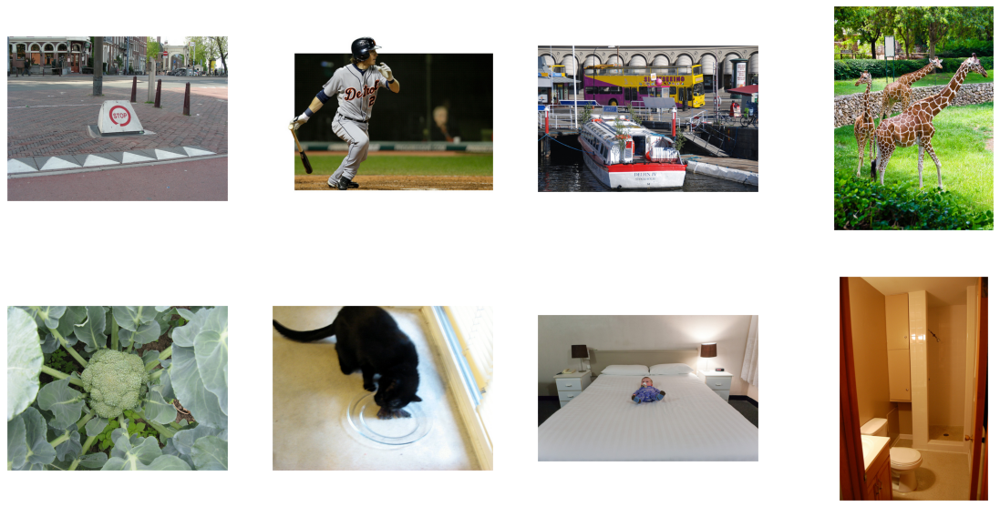

In [8]:
print('length of dataset:',len(coverit_dataset))

fig,axis = plt.subplots(2,4, figsize=(20,10))

for i in range(4):
    cover,hide = coverit_dataset[i]
    print(i, cover.shape, hide.shape)
    axis[0,i].imshow(cover)
    axis[1,i].imshow(hide)
    
    for ax in axis[:,i]:
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])

## Transformations

In [9]:
class ToPILImage(object):
    """Converts a torch.*Tensor of shape C x H x W or a numpy ndarray of shape
    H x W x C to a PIL.Image while preserving value range.
    """

    def __call__(self, sample):
        res=[]
        
        for pic in sample:
            npimg = pic
            mode = None
            if isinstance(pic, torch.FloatTensor):
                pic = pic.mul(255).byte()
            if torch.is_tensor(pic):
                npimg = np.transpose(pic.numpy(), (1, 2, 0))
            assert isinstance(npimg, np.ndarray), 'pic should be Tensor or ndarray'
            if npimg.shape[2] == 1:
                npimg = npimg[:, :, 0]

                if npimg.dtype == np.uint8:
                    mode = 'L'
                if npimg.dtype == np.int16:
                    mode = 'I;16'
                if npimg.dtype == np.int32:
                    mode = 'I'
                elif npimg.dtype == np.float32:
                    mode = 'F'
            else:
                if npimg.dtype == np.uint8:
                    mode = 'RGB'
            assert mode is not None, '{} is not supported'.format(npimg.dtype)
            res.append(Image.fromarray(npimg, mode=mode))
        return res


In [10]:
class PadCenterCrop(object):
    """
    Get the center/random crop of an image with given size. If image is too small pad it accordingly.
    """

    def __init__(self, out_size, is_random_crop=False):
        if isinstance(out_size, int):
            self.out_size = (out_size, out_size)
        elif isinstance(out_size, tuple):
            self.out_size = out_size
        else:
            raise Exception('Expect int or tuple only!')
        
        self.random_crop = is_random_crop

    def __call__(self, sample):
        res=[]
        
        for img in sample:
#             breakpoint()
            w, h = img.size
            th, tw = self.out_size

            diff = min(img.size) - max(self.out_size)

            if diff < 0:
                img = ImageOps.expand(img, border=-diff, fill=0)
                w, h = img.size


            if w == tw and h == th:
                res.append(img)
                break


            if self.random_crop:
                x1 = random.randint(0, w - tw)
                y1 = random.randint(0, h - th)
            else:
                x1 = (w - tw)/2 
                y1 = (h - th)/2 
            
            res.append(img.crop((x1, y1, x1 + tw, y1 + th)))
            
            
        return res

In [11]:
class ToTensor(object):
    """Converts a PIL.Image or numpy.ndarray (H x W x C) in the range
    [0, 255] to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0].
    """
    def __init__(self,is_gray = False, do_normalize = True):
        self.is_gray = is_gray
        
        
    def __call__(self, sample):
        res=[]
        
        for pic in sample:
            if isinstance(pic, np.ndarray):
                # handle numpy array
                img = torch.from_numpy(pic.transpose((2, 0, 1)))
                # backard compability
                res.append(img.float().div(255))
                break
            # handle PIL Image
            if pic.mode == 'I':
                img = torch.from_numpy(np.array(pic, np.int32, copy=False))
            elif pic.mode == 'I;16':
                img = torch.from_numpy(np.array(pic, np.int16, copy=False))
            else:
                img = torch.ByteTensor(torch.ByteStorage.from_buffer(pic.tobytes()))
            # PIL image mode: 1, L, P, I, F, RGB, YCbCr, RGBA, CMYK
            if pic.mode == 'YCbCr':
                nchannel = 3
            elif pic.mode == 'I;16':
                nchannel = 1
            else:
                nchannel = len(pic.mode)
            img = img.view(pic.size[1], pic.size[0], nchannel)

            if self.is_gray:
                coef = torch.tensor([0.299,0.587,0.114])
                img = (img * coef.view(1,1,-1)).sum(axis=-1,keepdims=True)

            img = img.transpose(0, 1).transpose(0, 2).contiguous()
            if isinstance(img, torch.ByteTensor):
                res.append(img.float().div(255))
            else:
                res.append(img.div(255))
                
        return res

In [12]:
# toPIL = ToPILImage()
# pcc = PadCenterCrop(out_size=IMAGE_SIZE)
# tten = ToTensor()

In [13]:
# toPIL(sample)

In [14]:
# tten(pcc(toPIL(sample)))[1].shape

In [15]:
# fig,axis = plt.subplots(4,4, figsize=(20,20))
# axis = axis.reshape(-1)
# for i,ax in enumerate(axis):
#     sample = crop(toPIL(coverit_dataset[i]))
#     print(i, sample.size)
#     ax.imshow(sample)
#     ax.grid(False)
#     ax.set_xticks([])
#     ax.set_yticks([])

In [16]:
# from inspect import getsource
# print(getsource(transforms.ToPILImage))

## Transformed Dataset

In [17]:
coverit_dataset_transformed = CoverItDataset(root_dir=f'{PROJECT_DIR}/data/raw/coco-test2017',
                                             transform=transforms.Compose([
                                                 ToPILImage(),
                                                 PadCenterCrop(out_size=IMAGE_SIZE),
                                                 ToTensor(is_gray=False)
                                             ]))

# of collisions: 0


In [18]:
print('length of dataset:',len(coverit_dataset_transformed))

length of dataset: 40670


In [19]:
def show_image(image, fig_size = (5,5), log_dims=False, is_return=False):
    """
    Args:
        image: tensor
    """
    if len(image.shape) == 2:
        image = image[None,:,:]
        
    is_colored = not (image.shape[0] == 1)
    if is_colored:
        image_np = image.numpy().transpose(1,2,0)
    else:
        image_np = image.numpy()

    if log_dims:
        print(i, image_np.shape)

    if is_colored:
        plt.imshow(image_np)
    else:
        plt.imshow(image_np[0] ,cmap=plt.get_cmap('gray'))
    
    ax,fig = plt.gca(), plt.gcf()
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    if fig_size:fig.set_size_inches(fig_size)
    
    if is_return:
        return fig

In [20]:
hide,cover = coverit_dataset_transformed[0]
print(hide.shape, cover.shape)

torch.Size([3, 256, 256]) torch.Size([3, 256, 256])


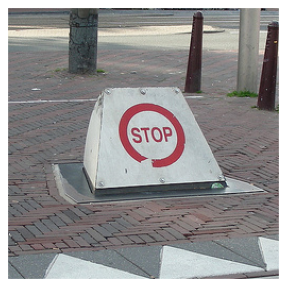

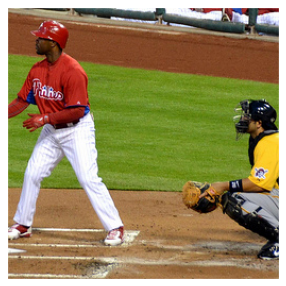

In [21]:
show_image(hide, is_return=False)
plt.show()
show_image(cover, is_return=False)
plt.show()

## Data Loader

Dataloader gives batch of hide and cover images in a list for each iteration

In [22]:
dataloader = DataLoader(coverit_dataset_transformed, batch_size = BATCH_SIZE, num_workers=4, shuffle=False)

In [23]:
hide, cover = next(iter(dataloader))

In [24]:
print(hide.shape, cover.shape)

torch.Size([16, 3, 256, 256]) torch.Size([16, 3, 256, 256])


In [25]:
def show_batch(batch, figsize=(10,10), log_dims=False, is_return=False, title=None):
    """
    Args:
        batch: tensor
    """
    subplot_size = int(batch.shape[0]**(1/2))
    is_colored = not (batch.shape[1] == 1)

    batch_np = batch.numpy().transpose(0, 2, 3, 1)

    fig, axis = plt.subplots(subplot_size, subplot_size, figsize=figsize)
    axis = axis.reshape(-1)
    for i, ax in enumerate(axis):
        sample = batch_np[i]
        if log_dims:
            print(i, sample.shape)

        if is_colored:
            ax.imshow(sample)
        else:
            ax.imshow(sample.squeeze(), cmap=plt.get_cmap('gray'))

        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
    if title: fig.suptitle(title, fontsize=16);
    fig.tight_layout(rect=[0, 0.03, 1, 0.95]);
    if is_return:
        return fig

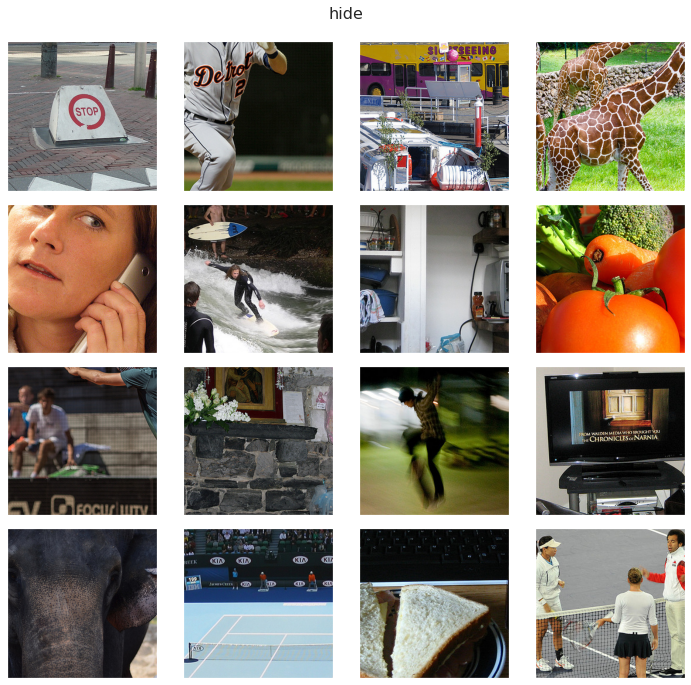

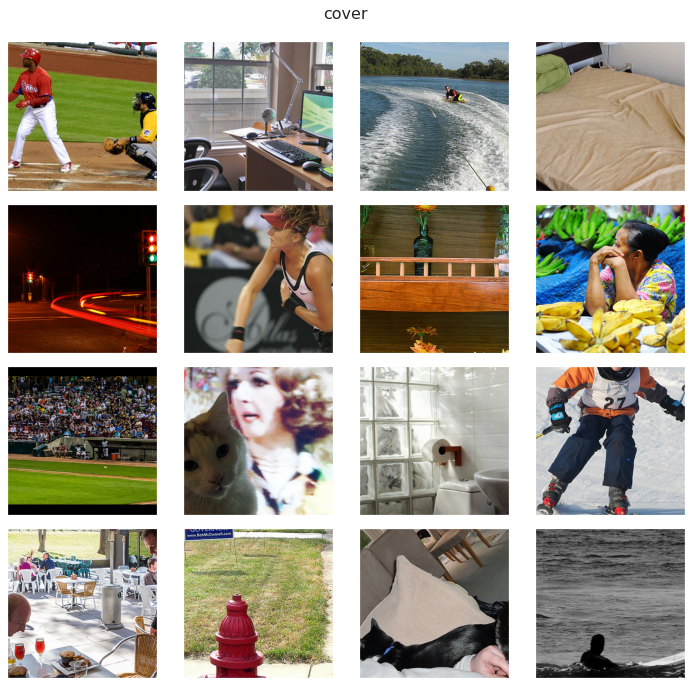

In [26]:
show_batch(hide, title='hide')
plt.show()

show_batch(cover, title='cover')
plt.show()

# Model

In [27]:
def calc_cnn(
        input_size=256,
        padding=1,
        kernel_size=3,
        stride=1):
    output_size = (input_size+2*padding-kernel_size)//stride + 1
    return output_size

calc_cnn()

256

### HidingNet

In [28]:
class HidingUNet(nn.Module):
    """
    Takes list of 2 input images -> convert them to 1 hidden image
    input   : [(col) x 256 x 256, (col) x 256 x 256] #hide and cover
    output  : (col) x 256 x 256 #hidden
    """

    def __init__(self):
        super(HidingUNet, self).__init__()

        self.conv_1  = nn.Conv2d(6, 16, 3, 1, 1)  
#         self.bnorm_1 = nn.BatchNorm2d(12)
        self.drop_1  = nn.Dropout2d(p=0.2)
        self.conv_1_2  = nn.Conv2d(16, 16, 3, 1, 1) 
        
        self.maxp_1  = nn.MaxPool2d(2,2)       
        self.conv_2  = nn.Conv2d(16, 32, 3, 1, 1)
#         self.bnorm_2 = nn.BatchNorm2d(12)
        self.drop_2  = nn.Dropout2d(p=0.2)
        self.conv_2_2  = nn.Conv2d(32, 32, 3, 1, 1)

        self.maxp_2  = nn.MaxPool2d(2,2)        
        self.conv_3  = nn.Conv2d(32, 64, 3, 1, 1)
#         self.bnorm_3 = nn.BatchNorm2d(12)
        self.drop_3  = nn.Dropout2d(p=0.2)
        self.conv_3_2  = nn.Conv2d(64, 64, 3, 1, 1)
############
        self.maxp_3  = nn.MaxPool2d(2,2) 
        self.conv_4  = nn.Conv2d(64, 128, 3, 1, 1)
#         self.bnorm_4 = nn.BatchNorm2d(12)
        self.drop_4  = nn.Dropout2d(p=0.2)
        self.conv_4_2  = nn.Conv2d(128, 64, 3, 1, 1)
#############
        self.upsm_1  = nn.UpsamplingBilinear2d(scale_factor=2)
#         self.bnorm_3 = nn.BatchNorm2d(12)
        self.conv_5  = nn.Conv2d(64, 64, 3, 1, 1)
        self.drop_5  = nn.Dropout2d(p=0.2)
        self.conv_5_2  = nn.Conv2d(64, 32, 3, 1, 1)

        self.upsm_2  = nn.UpsamplingBilinear2d(scale_factor=2)
#         self.bnorm_4 = nn.BatchNorm2d(12)
        self.conv_6  = nn.Conv2d(32, 32, 3, 1, 1)
        self.drop_6  = nn.Dropout2d(p=0.2)
        self.conv_6_2  = nn.Conv2d(32, 16, 3, 1, 1)
       
        self.upsm_3  = nn.UpsamplingBilinear2d(scale_factor=2)
#         self.bnorm_5 = nn.BatchNorm2d(12)
        self.conv_7  = nn.Conv2d(16, 16, 3, 1, 1)
        self.drop_7  = nn.Dropout2d(p=0.2)
        self.conv_7_2  = nn.Conv2d(16, 3, 3, 1, 1)
        
    def forward(self, input, bool_drop=False):
        """
        input(list): [hide,cover]
        return(tensor): hidden
        """
        concated = torch.cat(input, dim=1)  # [6, 256, 256] concat along color axis

        #down
        d1 = F.leaky_relu(self.conv_1(concated)) # [16, 256, 256]
        if bool_drop: d1 = self.drop_1(d1);
        d1 = F.leaky_relu(self.conv_1_2(d1))  # [16, 256, 256]
        
        d2 = self.maxp_1(d1)    # [16, 128, 128]  
        d2 = F.leaky_relu(self.conv_2(d2))    # [32, 128, 128]
        if bool_drop: d2 = self.drop_2(d2)
        d2 = F.leaky_relu(self.conv_2_2(d2))  # [32, 128, 128]
        
        d3 = self.maxp_2(d2)    # [32, 64, 64]  
        d3 = F.leaky_relu(self.conv_3(d3))    # [64, 64, 64]
        if bool_drop: d3 = self.drop_3(d3)
        d3 = F.leaky_relu(self.conv_3_2(d3))  # [64, 64, 64]
        
        #bottom
        b = self.maxp_3(d3)     # [64, 32, 32]
        b = F.leaky_relu(self.conv_4(b))      # [128, 32, 32]
        if bool_drop: b = self.drop_4(b)
        b = F.leaky_relu(self.conv_4_2(b))    # [64, 32, 32]
        
        #up
        u3 = self.upsm_1(b)     # [64, 64, 64]
        u3 = d3+u3              # [64, 64, 64]    
        u3 = F.leaky_relu(self.conv_5(u3))    # [64, 64, 64]
        if bool_drop: u3 = self.drop_5(u3)
        u3 = F.leaky_relu(self.conv_5_2(u3))  # [32, 64, 64]
        
        u2 = self.upsm_2(u3)    # [32, 128, 128]
        u2 = d2+u2              # [32, 128, 128]    
        u2 = F.leaky_relu(self.conv_6(u2))    # [32, 128, 128]
        if bool_drop: u2 = self.drop_6(u2)
        u2 = F.leaky_relu(self.conv_6_2(u2))  # [16, 128, 128]
        
        u1 = self.upsm_3(u2)    # [16, 256, 256]
        u1 = d1+u1              # [16, 256, 256]    
        u1 = F.leaky_relu(self.conv_7(u1))    # [16, 256, 256]
        if bool_drop: u1 = self.drop_7(u1)
        out = F.leaky_relu(self.conv_7_2(u1)) # [3, 256, 256]
        
        return out

In [29]:
# HidingUNet()(batch).shape

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

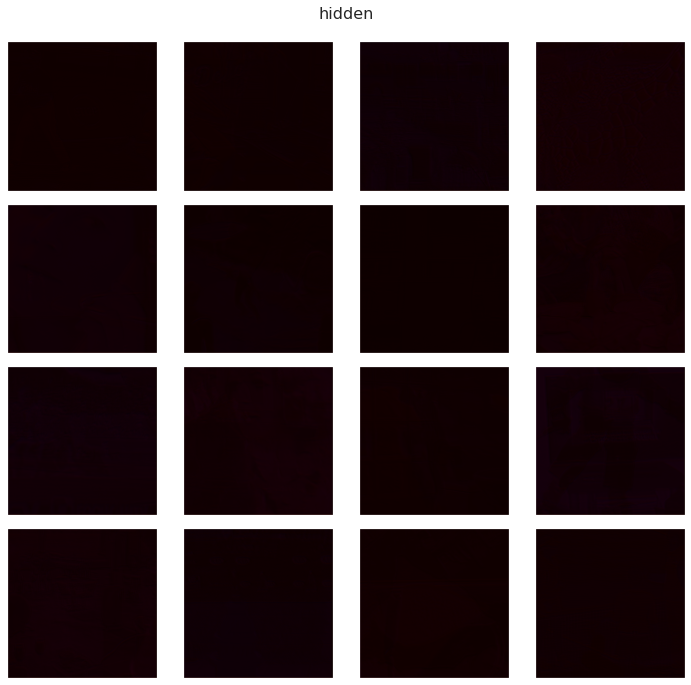

In [30]:
hidden = HidingUNet()([hide,cover],bool_drop=True).detach()
show_batch(hidden,figsize=(10,10),title='hidden')

In [31]:
hidden

tensor([[[[ 5.5347e-02,  5.2860e-02,  5.0702e-02,  ...,  4.4992e-02,
            4.5249e-02,  5.4540e-02],
          [ 5.8967e-02,  5.7664e-02,  5.1907e-02,  ...,  5.0453e-02,
            4.7409e-02,  4.9794e-02],
          [ 6.2861e-02,  6.6768e-02,  6.0863e-02,  ...,  5.6677e-02,
            5.6909e-02,  5.5670e-02],
          ...,
          [ 6.4304e-02,  5.9132e-02,  5.9551e-02,  ...,  6.0138e-02,
            5.7072e-02,  5.4685e-02],
          [ 4.9387e-02,  5.4687e-02,  5.1187e-02,  ...,  5.1321e-02,
            5.4797e-02,  5.8732e-02],
          [ 6.7008e-02,  7.1706e-02,  7.1500e-02,  ...,  7.2801e-02,
            7.2562e-02,  6.4492e-02]],

         [[-6.0290e-04, -6.3658e-04, -7.7482e-04,  ..., -7.2972e-04,
           -7.9030e-04, -7.3766e-04],
          [-7.3701e-04, -8.9992e-04, -8.3897e-04,  ..., -7.5985e-04,
           -8.0034e-04, -7.6372e-04],
          [-6.6696e-04, -8.5904e-04, -8.6703e-04,  ..., -8.0757e-04,
           -8.0040e-04, -7.8973e-04],
          ...,
     

**Look at transformerdecoder!!!**

### RevealNet

In [32]:
class RevalingNet(nn.Module):
    """
    Takes list of 2 input images -> output revealed hide image
    input   : [(col) x 256 x 256, (col) x 256 x 256] #hidden and cover
    output  : (col) x 256 x 256 #revealed hide
    """
    def __init__(self):
        super(RevalingNet, self).__init__()
        
        self.conv1 = nn.Conv2d(6, 3, 3, 1, 1)
        self.bnorm_1 = nn.BatchNorm2d(3)
        self.conv2 = nn.Conv2d(3, 3, 3, 1, 1)
        self.bnorm_2 = nn.BatchNorm2d(3)
        self.conv3 = nn.Conv2d(3, 3, 3, 1, 1)
        
    def forward(self, input):
        
        concated = torch.cat(input, dim=1)  # [6, 256, 256] concat along color axis
        
        x = F.leaky_relu(self.conv1(concated)) # [3, 256, 256] 
        x = self.bnorm_1(x)
        x = F.leaky_relu(self.conv2(x)) # [3, 256, 256]
        x = self.bnorm_2(x)
        x = F.leaky_relu(self.conv3(x)) # [3, 256, 256]
        
        return x #return hide

        

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

torch.Size([16, 3, 256, 256])

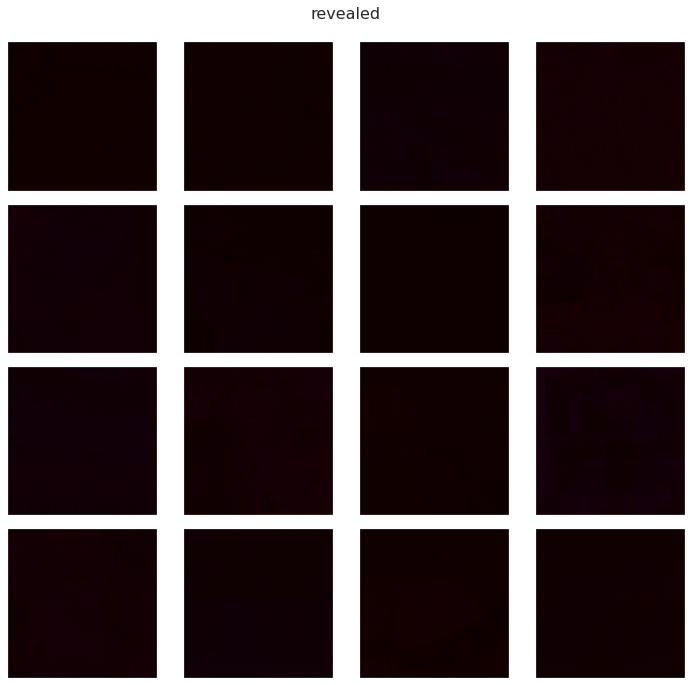

In [33]:
rev_hide = RevalingNet()([hidden,cover]).detach()
show_batch(hidden,figsize=(10,10),title='revealed')
rev_hide.shape

### CoverIt

In [34]:
class CoverIt(nn.Module):
    def __init__(self, hidenet, revealnet):
        super(CoverIt,self).__init__()
        self.hidenet = hidenet
        self.revealnet = revealnet
    def forward(self,hide_cover):
        hide,cover = hide_cover
        hidden = self.hidenet(hide_cover)
        rev_hide = self.revealnet([hidden,cover])
        return hidden, rev_hide

In [35]:
hidenet = HidingUNet()#.cuda()
revealnet = RevalingNet()#.cuda()
coverit = CoverIt(hidenet,revealnet).cuda()

## Results Before Traning

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

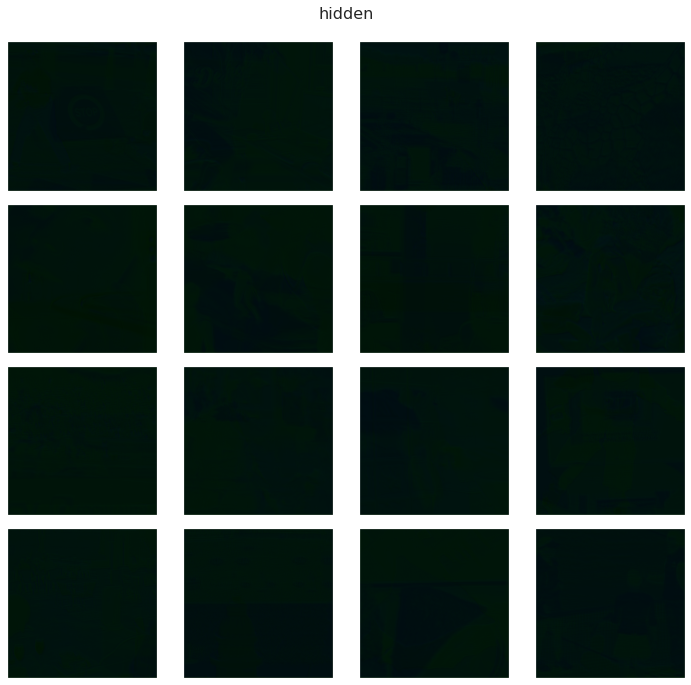

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

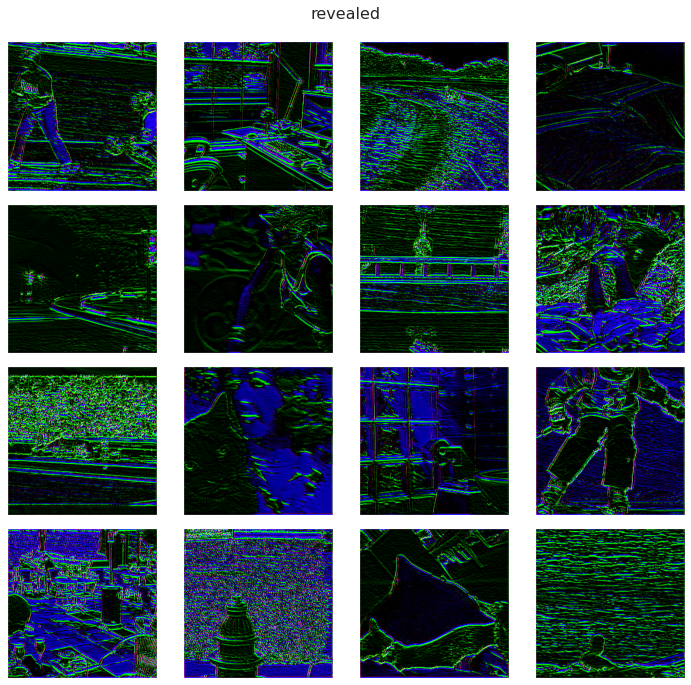

In [36]:
hide=hide.cuda()
cover=cover.cuda()
batch=[hide,cover]

hidden, rev_hide = coverit(batch)
hidden = hidden.detach().cpu()
rev_hide = rev_hide.detach().cpu()

show_batch(hidden,figsize=(10,10),title='hidden')
plt.show()
show_batch(rev_hide,figsize=(10,10),title='revealed')
plt.show()


In [37]:
# removing early experiments
# !rm -rf logs

In [38]:
from torch.utils.tensorboard import SummaryWriter
from datetime import datetime
# Sets up a timestamped log directory.
logdir = "logs/train_data/hidingnet_v3_" + datetime.now().strftime("%Y%m%d-%H%M")
print(logdir)
# Creates a file writer for the log directory.
writer = SummaryWriter(logdir)

logs/train_data/hidingnet_v3_20200705-1226


In [39]:
def show_input_output(hide,cover,hidden,rev_hide, figsize=(4,16), log_dims=False, is_return=False):
    """
    16*4
    
    Args:
        hide:     tensor_image
        cover:    tensor_image
        hidden:   tensor_image
        rev_hide: tensor_image
    """
    is_colored = not (hide.shape[1] == 1)

    hide_np = hide.numpy().transpose(0, 2, 3, 1)
    cover_np = cover.numpy().transpose(0, 2, 3, 1)
    hidden_np = hidden.numpy().transpose(0, 2, 3, 1)
    rev_hide_np = rev_hide.numpy().transpose(0, 2, 3, 1)

    fig, axis = plt.subplots(4, hide.shape[0], figsize=figsize)
    
    
    for col in range(hide.shape[0]):
        for row,np_img in enumerate([hide_np,cover_np,hidden_np,rev_hide_np]):
            ax = axis[row,col]
    
            sample = np_img[col]
            
            if log_dims:
                print(row,col, sample.shape)
                
            if is_colored:
                ax.imshow(sample)
            else:
                ax.imshow(sample.squeeze(), cmap=plt.get_cmap('gray'))

            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])

    if is_return:
        return fig

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

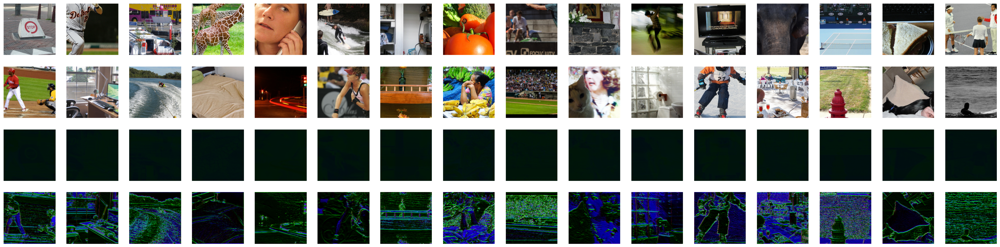

In [40]:
show_input_output(hide.cpu(),cover.cpu(),hidden.detach().cpu(),rev_hide.detach().cpu(), figsize=(40,10), is_return=False)

#### start tensorboard

In [36]:
# !tensorboard --logdir=./logs

## Load Model

In [41]:
# model_id = logdir.split('/')[-1]
model_id = 'hidingnet_v3_20200531-1722'

print(model_id)
model_dir = f"./models/{model_id}"
print(model_dir)

hidingnet_v3_20200531-1722
./models/hidingnet_v3_20200531-1722


In [42]:
#Create Dirs if doesn't exist

os.makedirs(f"./generated_images/{model_id}", exist_ok=True)
os.makedirs(f'./models/{model_id}/encoder',exist_ok=True)
os.makedirs(f'./models/{model_id}/decoder',exist_ok=True)

In [43]:
# load_specific = True


def load_model(encoder, decoder, model_dir, load_specific=None):
    '''
    load_specific=[encoderpath,decoderpath]
    '''
    
    start_epoch=0
    if load_specific:
        encoder.load_state_dict(torch.load(load_specific[0]))
        decoder.load_state_dict(torch.load(load_specific[1]))
        print('Loaded model parameters!')
    else:
        try:
            epoch = max([int(i.split('.')[0].split('_')[1]) for i in os.listdir(f'{model_dir}/encoder')])
            print(f"Found early model with parameters of epoch {epoch}")
            encoder_path = f"{model_dir}/encoder/encoder_{epoch}.pth"
            decoder_path = f"{model_dir}/decoder/decoder_{epoch}.pth"
            print("encoder_path:",encoder_path)
            
            encoder.load_state_dict(torch.load(encoder_path))
            decoder.load_state_dict(torch.load(decoder_path))
            print('Loaded model parameters!')
            
            start_epoch = int(start_epoch)+1
            
        except ValueError: # No saved models
            print("Could't find early model parameters!")
        
    print(f"Starting epoch: {start_epoch}")
    return start_epoch

In [44]:
for param in hidenet.parameters():
    print(param[0])
    break

tensor([[[-2.4360e-02, -1.3395e-01,  2.5895e-02],
         [ 2.4956e-02,  6.2567e-02,  1.0640e-01],
         [-4.1947e-02, -4.5119e-02, -1.7758e-02]],

        [[-2.1677e-02,  1.2847e-01, -1.1298e-01],
         [-9.4052e-02, -1.3063e-01, -9.0945e-02],
         [ 1.0303e-01,  1.0739e-01, -5.4683e-03]],

        [[ 1.3369e-01, -1.3599e-01, -5.3234e-02],
         [ 5.1852e-02,  1.1434e-01, -1.3435e-01],
         [-1.0850e-01,  7.2697e-02, -3.7112e-02]],

        [[ 7.1914e-02,  1.3506e-04,  1.8762e-03],
         [ 8.7440e-02,  1.0787e-01,  1.7633e-02],
         [-2.1949e-05,  7.5417e-02, -7.0998e-02]],

        [[ 6.8303e-02,  2.0647e-02,  2.4853e-02],
         [ 1.2792e-01, -1.5569e-02, -3.1078e-02],
         [-5.0385e-02, -3.6191e-02, -9.7138e-02]],

        [[-5.7649e-02, -4.3004e-02, -1.9489e-02],
         [ 4.7174e-02,  2.2923e-02,  3.6016e-02],
         [-3.2180e-02, -1.5190e-02,  9.5874e-02]]], device='cuda:0',
       grad_fn=<SelectBackward>)


In [45]:
load_ = ['/home/kazim/Desktop/project/cover_it/models/hidingnet_v3_20200531-1722/encoder/encoder_10.pth',
        '/home/kazim/Desktop/project/cover_it/models/hidingnet_v3_20200531-1722/decoder/decoder_10.pth']
# load_ = None

start_epoch = load_model(hidenet, revealnet, model_dir=model_dir,
                         load_specific=load_)
start_epoch

Loaded model parameters!
Starting epoch: 0


0

In [46]:
for param in hidenet.parameters():
    print(param[0])
    break

tensor([[[-0.0477,  0.0378,  0.0628],
         [-0.0664, -0.0315, -0.0278],
         [ 0.0793, -0.0560,  0.0043]],

        [[ 0.0541,  0.0670, -0.0219],
         [ 0.0495,  0.0158, -0.0256],
         [-0.1050,  0.0167, -0.0089]],

        [[-0.1174, -0.0739, -0.0535],
         [ 0.0673,  0.0993, -0.0185],
         [-0.0935,  0.1385,  0.0878]],

        [[ 0.2000, -0.0118, -0.0109],
         [ 0.1545,  0.2010,  0.1290],
         [ 0.2410,  0.1939,  0.1077]],

        [[-0.0216,  0.2023,  0.0181],
         [ 0.1640,  0.1180,  0.0133],
         [-0.0713,  0.1490,  0.0338]],

        [[-0.0011,  0.1263, -0.0465],
         [ 0.1012,  0.0882, -0.0338],
         [-0.0314,  0.0872, -0.0645]]], device='cuda:0',
       grad_fn=<SelectBackward>)


In [47]:
hide=hide.cuda()
cover=cover.cuda()
batch=[hide,cover]

hidden, rev_hide = coverit(batch)
hidden = hidden.detach().cpu()
rev_hide = rev_hide.detach().cpu()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

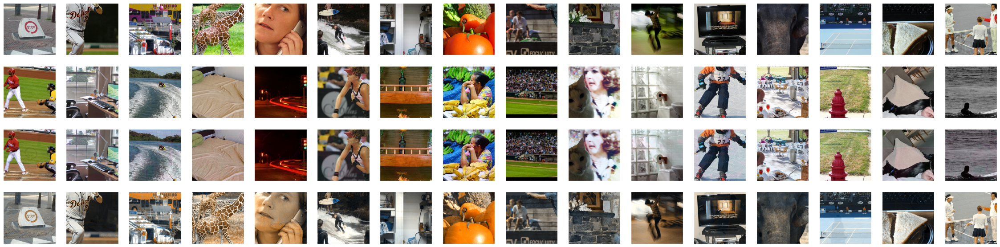

In [48]:
show_input_output(hide.cpu(),cover.cpu(),hidden.detach().cpu(),rev_hide.detach().cpu(), figsize=(40,10), is_return=False)

# Test Dataset

In [49]:
coverit_test_dataset = CoverItDataset(root_dir=f'{PROJECT_DIR}/data/raw/coco-val2017')

# of collisions: 0


length of test dataset: 5000
0 (480, 640, 3) (480, 640, 3)
1 (640, 425, 3) (426, 640, 3)
2 (640, 480, 3) (375, 500, 3)
3 (512, 640, 3) (424, 640, 3)


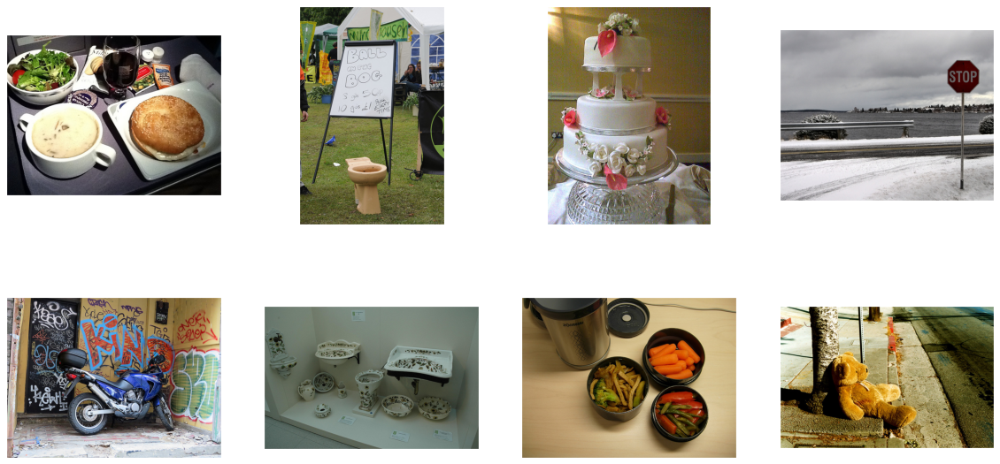

In [50]:
print('length of test dataset:',len(coverit_test_dataset))

fig,axis = plt.subplots(2,4, figsize=(20,10))

for i in range(4):
    cover,hide = coverit_test_dataset[i]
    print(i, cover.shape, hide.shape)
    axis[0,i].imshow(cover)
    axis[1,i].imshow(hide)
    
    for ax in axis[:,i]:
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])

In [51]:
coverit_test_dataset_transformed = CoverItDataset(root_dir=f'{PROJECT_DIR}/data/raw/coco-val2017',
                                             transform=transforms.Compose([
                                                 ToPILImage(),
                                                 PadCenterCrop(out_size=IMAGE_SIZE),
                                                 ToTensor(is_gray=False)
                                             ]))

# of collisions: 0


In [52]:
print('length of test dataset:',len(coverit_test_dataset_transformed))

length of test dataset: 5000


In [53]:
hide,cover = coverit_test_dataset_transformed[0]
print(hide.shape, cover.shape)

torch.Size([3, 256, 256]) torch.Size([3, 256, 256])


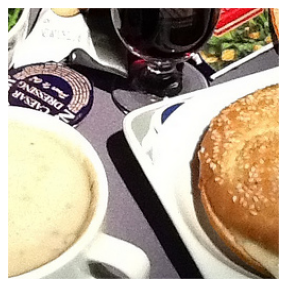

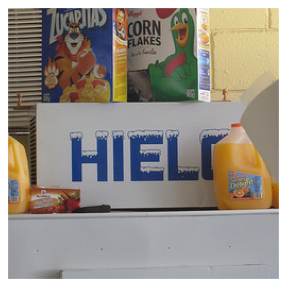

In [54]:
show_image(hide, is_return=False)
plt.show()
show_image(cover, is_return=False)
plt.show()

In [55]:
test_dataloader = DataLoader(coverit_test_dataset_transformed, batch_size = BATCH_SIZE, num_workers=4, shuffle=False)

In [56]:
hide, cover = next(iter(test_dataloader))

In [57]:
print(hide.shape, cover.shape)

torch.Size([16, 3, 256, 256]) torch.Size([16, 3, 256, 256])


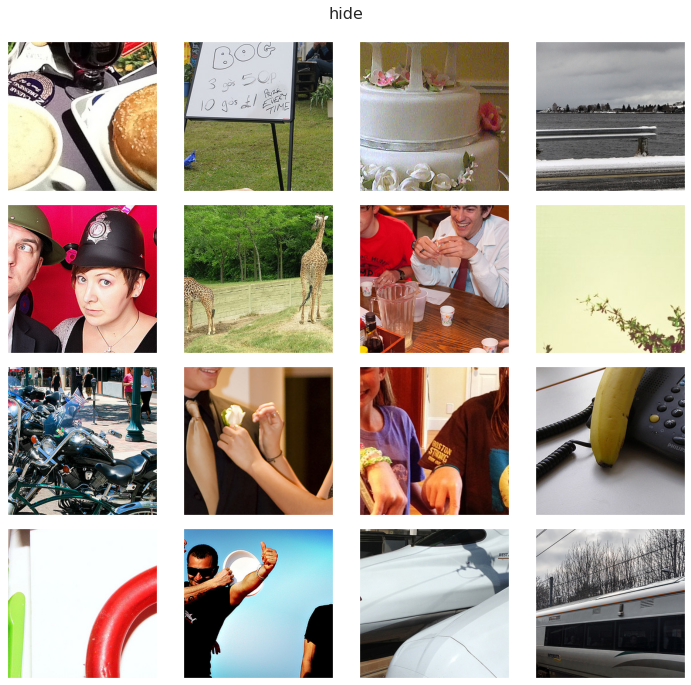

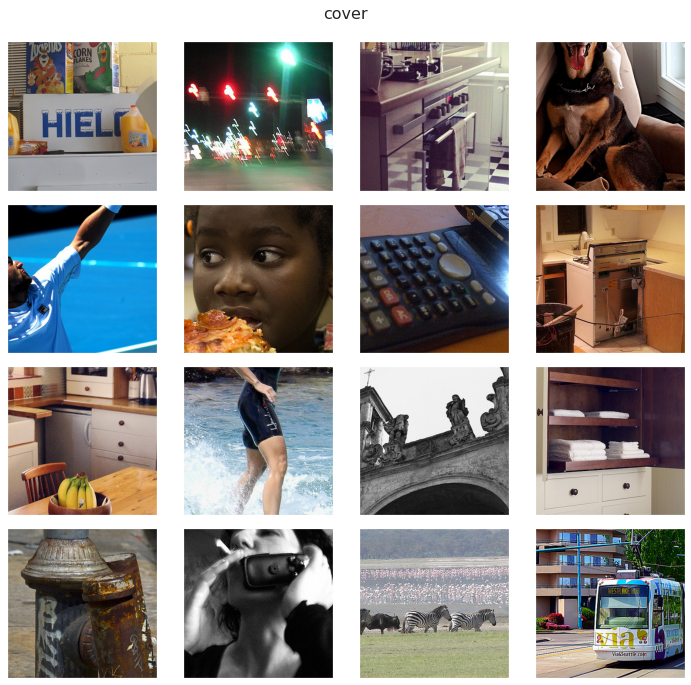

In [58]:
show_batch(hide, title='hide')
plt.show()

show_batch(cover, title='cover')
plt.show()

In [59]:
hide=hide.cuda()
cover=cover.cuda()
batch=[hide,cover]

hidden, rev_hide = coverit(batch)
hidden = hidden.detach().cpu()
rev_hide = rev_hide.detach().cpu()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

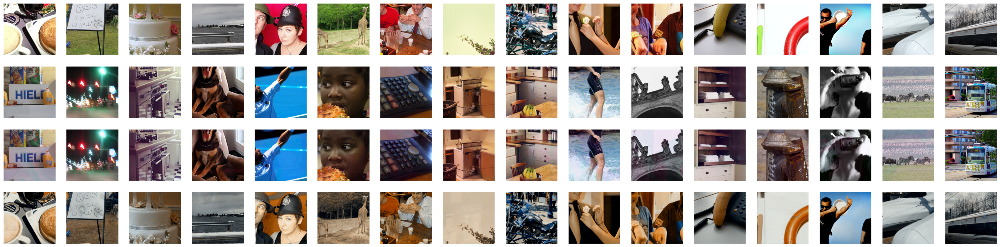

In [60]:
show_input_output(hide.cpu(),cover.cpu(),hidden.detach().cpu(),rev_hide.detach().cpu(), figsize=(40,10), is_return=False)

# Analysis

In [67]:
# show_input_output(hide.cpu(),cover.cpu(),10*hidden.detach().cpu()-cover.cpu(),10*rev_hide.detach().cpu()-hide.cpu(), figsize=(40,10), is_return=False)

## Revealed - Hide

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

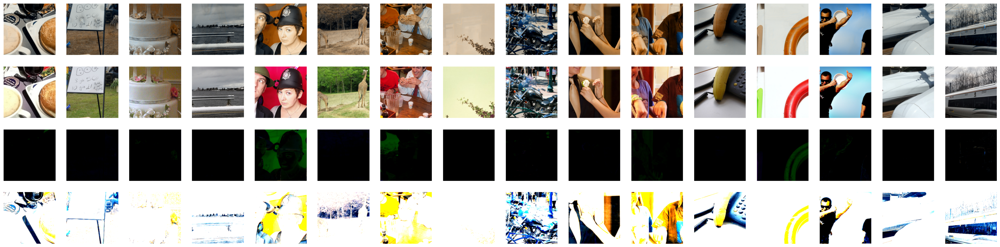

In [73]:
show_input_output(rev_hide.detach().cpu(), hide.cpu(),rev_hide.detach().cpu()-hide.cpu(),10*rev_hide.detach().cpu()-hide.cpu(), figsize=(40,10), is_return=False)

## Hidden - Cover

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

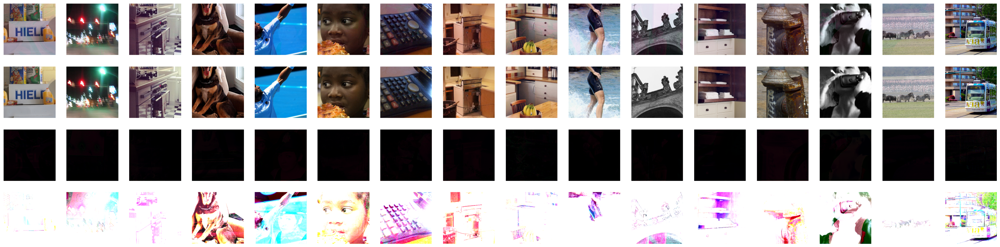

In [72]:
show_input_output(hidden.detach().cpu(),cover.cpu(),hidden.detach().cpu()-cover.cpu(), 10*hidden.detach().cpu()-cover.cpu(), figsize=(40,10), is_return=False)

## Hidden - Hide

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

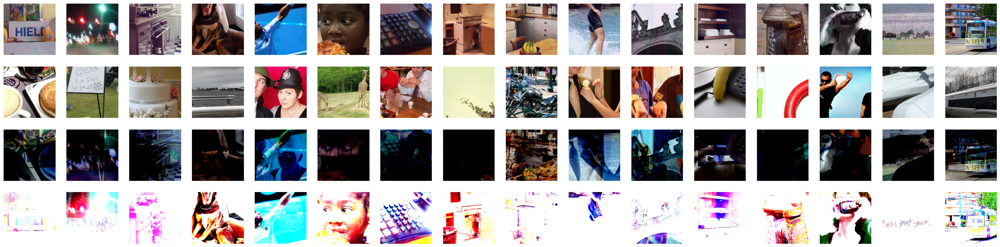

In [71]:
show_input_output(hidden.detach().cpu(), hide.cpu(),hidden.detach().cpu()-hide.cpu(), 10*hidden.detach().cpu()-hide.cpu(), figsize=(40,10), is_return=False)

# Training

In [59]:
coverit = CoverIt(hidenet,revealnet).cuda()

In [92]:
mse = nn.MSELoss()
optimizer = optim.Adam(coverit.parameters(), lr=0.001)
alpha=1/2

In [63]:
running_total_loss = 0.0
running_hiding_loss = 0.0
running_revealing_loss = 0.0


for epoch in range(start_epoch, start_epoch+100):  # loop over the dataset multiple times

    for step, data in enumerate(dataloader, 0):
        
#         data = data.type(torch.cuda.FloatTensor)

        # get the inputs
#         inputs = data.cuda()
        hide, cover = data
        hide=hide.cuda()
        cover=cover.cuda()
        batch=[hide,cover]
 

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        hidden, rev_hide = coverit(batch)
#         outputs = autoencoder(inputs)
        hiding_loss = mse(cover, hidden)
        revealing_loss = mse(hide, rev_hide)
        
        total_loss = alpha*hiding_loss + (1-alpha)*revealing_loss
        total_loss.backward()
        optimizer.step()

        running_total_loss += total_loss.item()
        running_hiding_loss += hiding_loss.item()
        running_revealing_loss += revealing_loss.item()
        
        if step % 100 == 0:    # every 100 mini-batches...

            print("Epoch: {} | Step: {}  =========  Loss: {:.3}".format(
                epoch, step, total_loss.item()))

            # ...log the running total_loss
            writer.add_scalar('training total_loss',
                              running_total_loss / 100,
                              global_step=epoch * len(dataloader) + step)
            writer.add_scalar('training hiding_loss',
                              running_total_loss / 100,
                              global_step=epoch * len(dataloader) + step)
            writer.add_scalar('training revealing_loss',
                              running_total_loss / 100,
                              global_step=epoch * len(dataloader) + step)

            # ...log a Matplotlib Figure showing the model's predictions on a
            # random mini-batch
            
            if step % 1000 == 0:  # every 1000 mini-batches...
                
                hidden = hidden.detach().cpu()
                rev_hide = rev_hide.detach().cpu()
                
                # create grids of images
                figure = show_input_output(hide.cpu(),cover.cpu(),hidden,rev_hide, figsize=(40,10), is_return=True)

                # write to tensorboard
                writer.add_figure('hide cover hidden revealed',
                                  figure,
                                  global_step=epoch * len(dataloader) + step)

                if epoch % 10 == 0: # every 10 epoch...
                    torch.save(hidenet.state_dict(),
                               f"./models/{model_id}/encoder/encoder_{epoch}.pth")
                    torch.save(revealnet.state_dict(),
                               f"./models/{model_id}/decoder/decoder_{epoch}.pth")
                    print('Saved model params to the disk!')

            running_total_loss = 0.0
            running_hiding_loss = 0.0
            running_revealing_loss = 0.0
print('Finished Training')

Epoch: 0 | Step: 0  =========  Loss: 0.241


Saved model params to the disk!
Epoch: 0 | Step: 100  =========  Loss: 0.0557
Epoch: 0 | Step: 200  =========  Loss: 0.0274
Epoch: 0 | Step: 300  =========  Loss: 0.0268
Epoch: 0 | Step: 400  =========  Loss: 0.0296
Epoch: 0 | Step: 500  =========  Loss: 0.0287
Epoch: 0 | Step: 600  =========  Loss: 0.0273
Epoch: 0 | Step: 700  =========  Loss: 0.0279
Epoch: 0 | Step: 800  =========  Loss: 0.0183
Epoch: 0 | Step: 900  =========  Loss: 0.0204
Epoch: 0 | Step: 1000  =========  Loss: 0.0272


Saved model params to the disk!
Epoch: 0 | Step: 1100  =========  Loss: 0.0208
Epoch: 0 | Step: 1200  =========  Loss: 0.022
Epoch: 0 | Step: 1300  =========  Loss: 0.0263
Epoch: 0 | Step: 1400  =========  Loss: 0.0185
Epoch: 0 | Step: 1500  =========  Loss: 0.0169
Epoch: 0 | Step: 1600  =========  Loss: 0.0182
Epoch: 0 | Step: 1700  =========  Loss: 0.0226
Epoch: 0 | Step: 1800  =========  Loss: 0.0177
Epoch: 0 | Step: 1900  =========  Loss: 0.0165
Epoch: 0 | Step: 2000  =========  Loss: 0.0192


Saved model params to the disk!


KeyboardInterrupt: 

Traceback (most recent call last):
  File "/usr/lib/python3.7/multiprocessing/queues.py", line 242, in _feed
    send_bytes(obj)
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe
Traceback (most recent call last):
  File "/usr/lib/python3.7/multiprocessing/queues.py", line 242, in _feed
    send_bytes(obj)
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, b

In [326]:
# torch.save(encoder.state_dict(),
#            f"./models/{model_id}/encoder/encoder_{epoch}.pth")
# torch.save(decoder.state_dict(),
#            f"./models/{model_id}/decoder/decoder{epoch}.pth")